# Deep learning cw2

**In this notebook, different models like AlexNet, ResNet-50, Inception-V3 will be applied on the popular food-101 dataset and comapred to each other to see which performs best in multi-class food classification**

In [ ]:
#imports
import os
import numpy as np
import pandas as pd

import cv2
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure

import tensorflow as tf
from tensorflow import keras

from keras import backend as K
from keras.layers import GlobalAveragePooling2D
from tensorflow.keras.layers import Dense,Dropout
from keras.preprocessing.image import ImageDataGenerator


from tensorflow.keras.models import Model
from keras.models import load_model
from keras.layers import Input


from keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.inception_v3 import InceptionV3

from google.colab.patches import cv2_imshow
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report

**Here, the dataset is downloaded to the Drive and the classes were chosen.**

In [ ]:
## Performing these steps for one time only To download the whole dataset
## Then reterive specific classes

# Downloading the dataset
#!wget http://data.vision.ee.ethz.ch/cvl/food-101.tar.gz
#Extracting the data
#!tar xzvf food-101.tar.gz 
# Copying needed images to the drive
# !cp -r '/content/food-101/images/apple_pie' '/content/drive/My Drive/food-101/images' 
# !cp -r '/content/food-101/images/caesar_salad' '/content/drive/My Drive/food-101/images' 
# !cp -r '/content/food-101/images/cheesecake' '/content/drive/My Drive/food-101/images' 
# !cp -r '/content/food-101/images/chicken_wings' '/content/drive/My Drive/food-101/images' 
#!cp -r '/content/food-101/images/spaghetti_bolognese' '/content/drive/My Drive/food-101/images' 
# !cp -r '/content/food-101/images/falafel' '/content/drive/My Drive/food-101/images' 
# !cp -r '/content/food-101/images/pizza' '/content/drive/My Drive/food-101/images' 
# !cp -r '/content/food-101/images/ice_cream' '/content/drive/My Drive/food-101/images' 
# !cp -r '/content/food-101/images/sushi' '/content/drive/My Drive/food-101/images' 
# !cp -r '/content/food-101/images/waffles' '/content/drive/My Drive/food-101/images' 

In [ ]:
#mounting googleDrive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#Load data
!unzip '/content/drive/MyDrive/food_images.zip' -d '/content' 

## Food-101 contains 101 class
**As this dataset cotains more than a 100 classes and it is too big, We will train the models on 10 classes only which are:**
<ul>
<li>Apple Pie</li>
<li>Caesar Salad</li>
<li>Cheesecake</li>
<li>Chicken Wings</li>
<li>Spaghetti Bolognese</li>
<li>Falafel</li>
<li>Pizza</li>
<li>Ice Cream</li>
<li>Sushi</li>
<li>Waffels</li>
</ul>


In [ ]:
# Choosed ten classes to train
classes_Names=['apple_pie','caesar_salad','cheesecake','chicken_wings','spaghetti_bolognese','falafel','pizza','ice_cream','sushi','waffles']

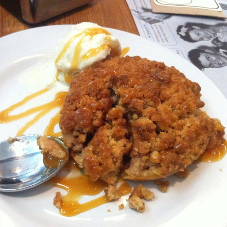

apple_pie


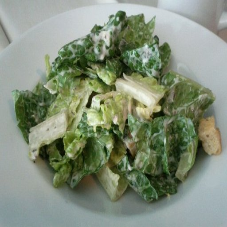

caesar_salad


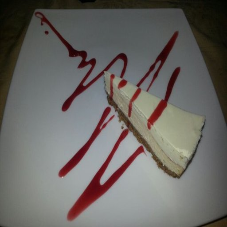

cheesecake


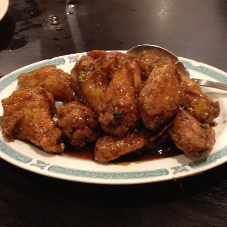

chicken_wings


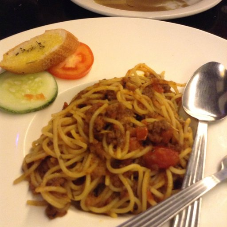

spaghetti_bolognese


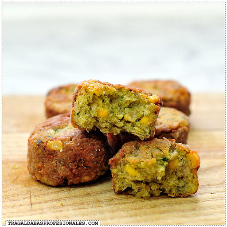

falafel


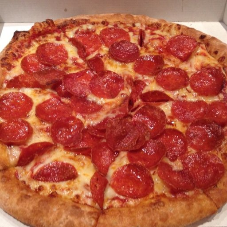

pizza


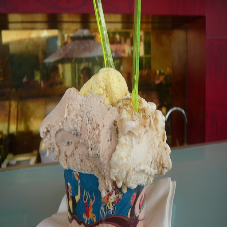

ice_cream


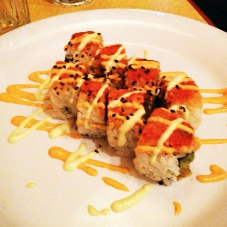

sushi


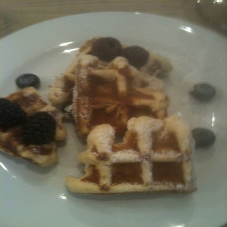

waffles


In [ ]:
# Loading samples of the images
for c in classes_Names:
  path='/content/images/'+c
  os.chdir(path)
  # Get image from each class directory
  img = os.listdir('./')[0]
  img=cv2.imread(img)
  # Resize img
  img=cv2.resize(img,(227,227))
  cv2_imshow(img)
  print(c)

In [ ]:
# Printing number of images for each class
for c in classes_Names:
  path='/content/images/'+c
  os.chdir(path)
  imgs=[file for file in os.listdir('./') if file.endswith('.jpg') or file.endswith('.png')]
  print('Number of images of class '+c+' : '+str(len(imgs)))


Number of images of class apple_pie : 1000
Number of images of class caesar_salad : 1000
Number of images of class cheesecake : 1000
Number of images of class chicken_wings : 1000
Number of images of class spaghetti_bolognese : 1000
Number of images of class falafel : 1000
Number of images of class pizza : 1000
Number of images of class ice_cream : 1000
Number of images of class sushi : 1000
Number of images of class waffles : 1000


In [ ]:
classes_Names

['apple_pie',
 'caesar_salad',
 'cheesecake',
 'chicken_wings',
 'spaghetti_bolognese',
 'falafel',
 'pizza',
 'ice_cream',
 'sushi',
 'waffles']

In [ ]:
#Specify the path of images
data_path='/content/images/'

**Now We Start splitting the data into training and validation using thekeras preprocessing method which is ImageDataGenerator ( latest additional feature Subset allowed to split train and test without generating train and test directires)**

In [ ]:
# Spliting the data using image generator
#(Last version added feature subset to divide data from one file with out separting files)
# Split train and test to 80:20 
train_gen=ImageDataGenerator(rescale=1./255,validation_split=0.2)
#Specify size of images, batchsize and class_names
# The set will be 43 for the whole 
train_generator = train_gen.flow_from_directory(
    directory=data_path,
    class_mode='categorical',
    target_size=(227,227),
    color_mode='rgb',
    batch_size=64,
    shuffle=True,
    seed=43,
    classes=classes_Names,
    subset='training')

Found 8000 images belonging to 10 classes.


In [ ]:
#Getting the test_set
val_gen=ImageDataGenerator(rescale=1./255,validation_split=0.2)
val_generator = val_gen.flow_from_directory(
    directory=data_path,
    class_mode='categorical',
    target_size=(227,227),
    color_mode='rgb',
    batch_size=64,
    shuffle=True,
    seed=43,
    classes=classes_Names,
    subset='validation')

Found 2000 images belonging to 10 classes.


## Initial Model: AlexNet
**Here we start the experiment by training the initial model without any parameter tuning or performance enhancement techniques**

In [ ]:
#Building AlexNet model
#AlexNet consists of two Conventional layers followed by maxpooling
#Then 3 coventional layers followed by maxpooling layer 
#Then 3 Fully connected layers, and dropput before last fc layer
# Batch normalization is addedd after each conventional layer to increse the speed of learning, and allowing much higher learning rates
model = keras.models.Sequential([
    keras.layers.Conv2D(filters=96, kernel_size=(11,11), strides=(4,4), activation='relu', input_shape=(227,227,3)),
    keras.layers.BatchNormalization(),
    keras.layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    keras.layers.Conv2D(filters=256, kernel_size=(5,5), strides=(1,1), activation='relu', padding="same"),
    keras.layers.BatchNormalization(),
    keras.layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    keras.layers.Conv2D(filters=384, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"),
    keras.layers.BatchNormalization(),
    keras.layers.Conv2D(filters=384, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"),
    keras.layers.BatchNormalization(),
    keras.layers.Conv2D(filters=256, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"),
    keras.layers.BatchNormalization(),
    keras.layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    keras.layers.Flatten(),
    keras.layers.Dense(4096, activation='relu'),
    keras.layers.Dropout(0.5),
    keras.layers.Dense(4096, activation='relu'),
    keras.layers.Dropout(0.5),
    keras.layers.Dense(10, activation='softmax')
])

In [ ]:
#Using adam optimizer with default optimizer 0.001 
model.compile(optimizer = keras.optimizers.Adam() , loss = "categorical_crossentropy", metrics=["accuracy"])

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 55, 55, 96)        34944     
_________________________________________________________________
batch_normalization (BatchNo (None, 55, 55, 96)        384       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 27, 27, 96)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 27, 27, 256)       614656    
_________________________________________________________________
batch_normalization_1 (Batch (None, 27, 27, 256)       1024      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 13, 13, 256)       0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 13, 13, 384)       8

In [ ]:
# Creating Callback to save model to drive
# it saves model if its loss was less than previous loss, to save the model with best weights
saveModel = tf.keras.callbacks.ModelCheckpoint(filepath='/content/drive/MyDrive/TrainedModels/AlexNoAug.hdf5', verbose=1, save_best_only=True, save_weights_only=True)

In [ ]:
# Training the model with 50 epochs
history=model.fit_generator(
      train_generator,
      steps_per_epoch = train_generator.samples // 64,
      validation_data = val_generator, 
      validation_steps = val_generator.samples // 64,
      epochs = 50,verbose=1,callbacks=[saveModel])

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1940: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/50
125/125 [==============================] - 47s 339ms/step - loss: 6.5770 - accuracy: 0.1663 - val_loss: 2.3120 - val_accuracy: 0.1517

Epoch 00001: val_loss improved from inf to 2.31200, saving model to /content/drive/MyDrive/TrainedModels/AlexNoAug.hdf5
Epoch 2/50
125/125 [==============================] - 44s 348ms/step - loss: 2.2151 - accuracy: 0.2254 - val_loss: 2.2280 - val_accuracy: 0.1905

Epoch 00002: val_loss improved from 2.31200 to 2.22802, saving model to /content/drive/MyDrive/TrainedModels/AlexNoAug.hdf5
Epoch 3/50
125/125 [==============================] - 43s 344ms/step - loss: 2.1051 - accuracy: 0.2624 - val_loss: 2.1398 - val_accuracy: 0.2223

Epoch 00003: val_loss improved from 2.22802 to 2.13979, saving model to /content/drive/MyDrive/TrainedModels/AlexNoAug.hdf5
Epoch 4/50
125/125 [==============================] - 43s 348ms/step - loss: 2.0506 - accuracy: 0.2815 - val_loss: 2.0664 - val_accuracy: 0.2601

Epoch 00004: val_loss improved from 2.13979 to 2

In [ ]:
#Saving History to the drive
AlexHist=pd.DataFrame(history.history)
with open('/content/drive/MyDrive/ModelHistory/alexNoAugHist.csv', mode='w') as f:
    AlexHist.to_csv(f) 

In [ ]:
# Reading model to plot learning curve
hist=pd.read_csv('/content/drive/MyDrive/ModelHistory/alexNoAugHist.csv')

**After the training is done, we checked the training information in the last 5 epochs**

In [ ]:
hist.tail()

,Unnamed: 0,loss,accuracy,val_loss,val_accuracy
45,45,0.437307,0.867375,1.905555,0.568548
46,46,0.450998,0.867375,1.817636,0.560988
47,47,0.435761,0.873000,1.838101,0.563004
48,48,0.370429,0.890125,1.737125,0.579637
49,49,0.323390,0.902125,2.574523,0.527218


**We created a helper function that takes the history of the model and plots the learning curve of that model**

In [ ]:
 # Defining helper function that takes the model's history and plot learning curve
 def evalFunction(histDF):
  # Ploting Learning curve
  figure(figsize=(20, 8))
  plt.subplot(1, 2, 1)
  # Reteriving leanring and validation accuracy
  plt.plot(histDF['accuracy'])
  plt.plot(histDF['val_accuracy'])
  plt.title('model accuracy')
  plt.ylabel('accuracy')
  plt.xlabel('Number of Epochs')
  plt.legend(['train', 'validation'], loc='upper right')
  # Ploting Loss Curve
  plt.subplot(1, 2, 2)
  # Reteriving leanring and validation loss
  plt.plot(histDF['loss'])
  plt.plot(histDF['val_loss'])
  plt.title('model loss')
  plt.ylabel('loss')
  plt.xlabel('Number of Epochs')
  plt.legend(['train', 'validation'], loc='upper right')
  plt.show()
  

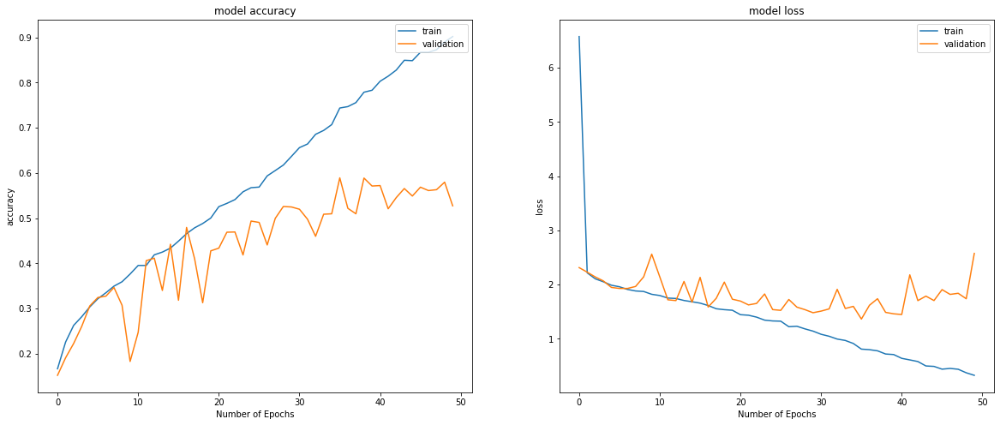

In [ ]:
# Plotting learning curve of alexNet
evalFunction(hist)

**As shown in the learning curves above, the model overfits, Small number of data may the reason, so Data augmentation will be applied, as a solution of overfitting**

In [ ]:
#Loading the model
model.load_weights('/content/drive/MyDrive/TrainedModels/AlexNoAug.hdf5')

**This Function contains all the metrics used to evaluate the models that will be used in order to be able to compare them later <br> The metrics used in this function are:**


*   Confusion Matrix
*   Accuracy Score
*   Classification Report



In [ ]:
def eval_Model(model):
 # Creating val without shuffle to get predications with the same order
  val_generator_Pred = val_gen.flow_from_directory(
      directory=data_path,
      class_mode='categorical',
      target_size=(227,227),
      color_mode='rgb',
      batch_size=64,
      shuffle=False,
      seed=43,
      classes=classes_Names,
      subset='validation')
  # Reading classes possibilites
  predictions=model.predict_generator(val_generator_Pred,steps = (2000//64)+1)
  # Getting predicted classes
  y_preds=np.argmax(predictions,axis=1)
  # Getting real classes
  y_label=val_generator_Pred.classes
  # Plot confussion_Matrix using sklearn function
  cm=confusion_matrix(y_label,y_preds)
  figure(figsize=(20, 8))
  plt.imshow(cm, interpolation='nearest', cmap=plt.cm.GnBu)
  plt.title('Confusion matrix',fontsize=15)
  plt.colorbar()
  plt.xticks(range(10),classes_Names, fontsize=12,rotation=60)
  plt.yticks(range(10),classes_Names, fontsize=12,verticalalignment="center")
  # Iteating over cells to write number of prediction for each class
  for i in range(cm.shape[0]):
      for j in range(cm.shape[1]):
          plt.text(j, i, format(cm[i, j], 'd'), horizontalalignment="center", color="white" if cm[i, j] > np.max(cm)/2. else "black")
  plt.xlabel('Predicted label',fontsize=15)
  plt.ylabel('True label',fontsize=15)
  # Calculat Accuracy and Classification Report
  print('\nAccuracy score: {:.2f}\n'.format(accuracy_score(y_preds,y_label)*100))
  print('Classification Report: \n'+str(classification_report(y_preds, y_label)))

Found 2000 images belonging to 10 classes.


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:2001: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  warnings.warn('`Model.predict_generator` is deprecated and '



Accuracy score: 58.95

Classification Report: 
              precision    recall  f1-score   support

           0       0.47      0.49      0.48       191
           1       0.80      0.81      0.80       197
           2       0.65      0.58      0.61       225
           3       0.70      0.58      0.64       244
           4       0.80      0.68      0.73       236
           5       0.47      0.44      0.45       210
           6       0.60      0.74      0.66       162
           7       0.58      0.48      0.52       242
           8       0.33      0.71      0.45        91
           9       0.51      0.50      0.51       202

    accuracy                           0.59      2000
   macro avg       0.59      0.60      0.59      2000
weighted avg       0.61      0.59      0.59      2000



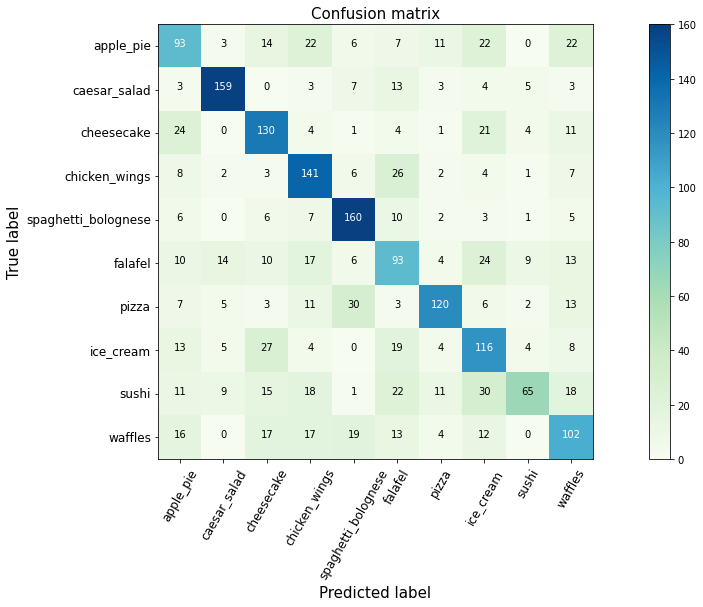

In [ ]:
eval_Model(model)

**Here we Perform the data augmentation process which is making clones of the data but with different properties like: rotation, lifting, and filpping**

In [ ]:
#Train with data Augmentation
#add random rotation between [-20,20] Angles
#changing image along axises
#Zooming images and flip it horizontialy
#We aply augmentation only to training set
train_augment=ImageDataGenerator(rescale=1./255,validation_split=0.2,
                           rotation_range=20,
                           shear_range=0.2,
                           zoom_range=0.2,
                           width_shift_range=0.1,
                           height_shift_range=0.1,
                           horizontal_flip=True)
# Then get images with augmentation
train_Augmented = train_augment.flow_from_directory(
    directory=data_path,
    class_mode='categorical',
    target_size=(227,227),
    color_mode='rgb',
    batch_size=64,
    shuffle=True,
    seed=43,
    classes=classes_Names,
    subset='training')

Found 8000 images belonging to 10 classes.


## Applying the models after Augmentation

### AlexNet
**Now we train the same AlexNet model trained above after augmentation to spot the difference between them**

In [ ]:
#Building another AlexNet model to avoid overwriting first model
model_Aug = keras.models.Sequential([
    keras.layers.Conv2D(filters=96, kernel_size=(11,11), strides=(4,4), activation='relu', input_shape=(227,227,3)),
    keras.layers.BatchNormalization(),
    keras.layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    keras.layers.Conv2D(filters=256, kernel_size=(5,5), strides=(1,1), activation='relu', padding="same"),
    keras.layers.BatchNormalization(),
    keras.layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    keras.layers.Conv2D(filters=384, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"),
    keras.layers.BatchNormalization(),
    keras.layers.Conv2D(filters=384, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"),
    keras.layers.BatchNormalization(),
    keras.layers.Conv2D(filters=256, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"),
    keras.layers.BatchNormalization(),
    keras.layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    keras.layers.Flatten(),
    keras.layers.Dense(4096, activation='relu'),
    keras.layers.Dropout(0.5),
    keras.layers.Dense(4096, activation='relu'),
    keras.layers.Dropout(0.5),
    keras.layers.Dense(10, activation='softmax')
])

In [ ]:
model_Aug.compile(optimizer = keras.optimizers.Adam() , loss = "categorical_crossentropy", metrics=["accuracy"])

In [ ]:
# Callbacks
#Defining callback to save model to the drive
#reduce learning rate by 0.7*LR, if val_loss not improved for 5 epochs
saveModel2 = tf.keras.callbacks.ModelCheckpoint(filepath='/content/drive/MyDrive/TrainedModels/AlexAug.hdf5', verbose=1, save_best_only=True, save_weights_only=True)
reduceLearningRate=tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.7, patience=10, verbose=1 ,mode='auto')


In [ ]:
history2=model_Aug.fit_generator(
      train_Augmented,
      steps_per_epoch = train_Augmented.samples // 64,
      validation_data = val_generator, 
      validation_steps = val_generator.samples // 64,
      epochs = 50,verbose=1,callbacks=[saveModel2,reduceLearningRate])

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1940: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/50
125/125 [==============================] - 140s 856ms/step - loss: 6.4635 - accuracy: 0.1577 - val_loss: 2.4501 - val_accuracy: 0.1401

Epoch 00001: val_loss improved from inf to 2.45005, saving model to /content/drive/MyDrive/TrainedModels/AlexAug.hdf5
Epoch 2/50
125/125 [==============================] - 108s 866ms/step - loss: 2.3267 - accuracy: 0.1930 - val_loss: 2.1792 - val_accuracy: 0.2198

Epoch 00002: val_loss improved from 2.45005 to 2.17923, saving model to /content/drive/MyDrive/TrainedModels/AlexAug.hdf5
Epoch 3/50
125/125 [==============================] - 108s 865ms/step - loss: 2.1936 - accuracy: 0.2226 - val_loss: 2.1175 - val_accuracy: 0.2555

Epoch 00003: val_loss improved from 2.17923 to 2.11747, saving model to /content/drive/MyDrive/TrainedModels/AlexAug.hdf5
Epoch 4/50
125/125 [==============================] - 107s 855ms/step - loss: 2.1478 - accuracy: 0.2431 - val_loss: 2.2424 - val_accuracy: 0.2243

Epoch 00004: val_loss did not improve from 2.11747

In [ ]:
# Saving accuarcy and loss of traning and validation
AlexAugHist=pd.DataFrame(history2.history)
with open('/content/drive/MyDrive/ModelHistory/alexAugHist.csv', mode='w') as f:
    AlexAugHist.to_csv(f) 

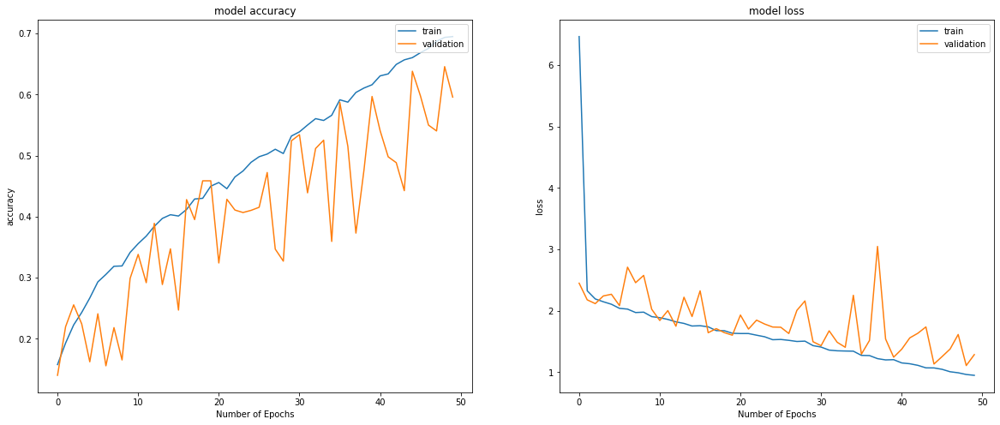

In [ ]:
hist2=pd.read_csv('/content/drive/MyDrive/ModelHistory/alexAugHist.csv')
evalFunction(hist2)

**looking at the learning curve above, it is observed that overfitting problem is minmized, but it is noted that validation_acc is not stable, as it goes up and down <br>**
**We will reduce learning_rate and train more 10 epochs to check if it will solve the problem**

In [ ]:
## reducing learning rate
model_Aug2=keras.models.load_model('/content/drive/MyDrive/TrainedModels/AlexAug.h5')
K.set_value(model_Aug2.lr, 0.0001)

In [ ]:
#Calbacks for the model
saveModel3 = tf.keras.callbacks.ModelCheckpoint(filepath='/content/drive/MyDrive/TrainedModels/AlexAug2.h5', verbose=1, save_best_only=True, save_weights_only=True)
reduceLearningRate=tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, verbose=1 ,mode='auto')

In [ ]:
history2_2=model_Aug2.fit_generator(
      train_Augmented,
      steps_per_epoch = train_Augmented.samples // 64,
      validation_data = val_generator, 
      validation_steps = val_generator.samples // 64,
      epochs = 10,verbose=1,callbacks=[saveModel3,reduceLearningRate])

In [ ]:
AlexAugHist2=pd.DataFrame(history2_2.history)
with open('/content/drive/MyDrive/ModelHistory/alexAugHist2.csv', mode='w') as f:
    AlexAugHist2.to_csv(f) 

In [ ]:
AlexAugHist=pd.read_csv('/content/drive/MyDrive/ModelHistory/alexAugHist.csv')
AlexAugHist2=pd.read_csv('/content/drive/MyDrive/ModelHistory/alexAugHist2.csv')

In [ ]:
AlexAugHist2.set_index(pd.Index([i for i in range(50,60)]),inplace=True)

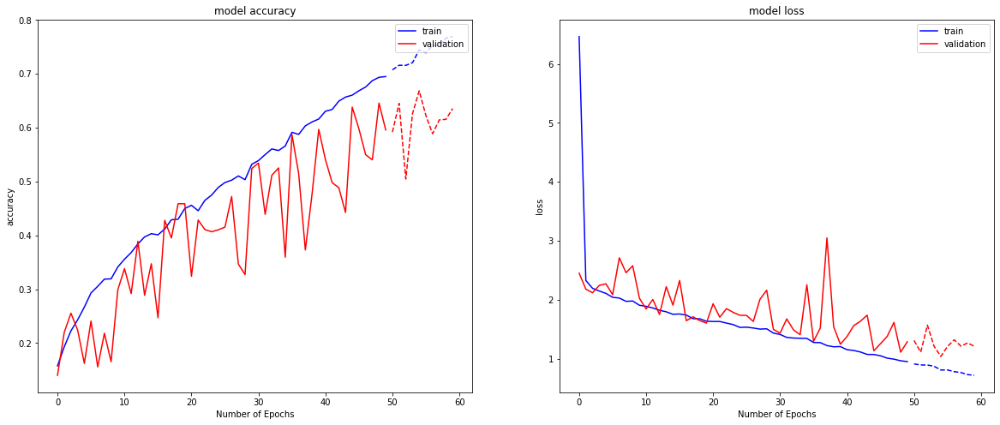

In [ ]:
  # Ploting Learning curve
  figure(figsize=(20, 8))
  plt.subplot(1, 2, 1)
  # Reteriving leanring and validation accuracy
  plt.plot(AlexAugHist['accuracy'],'b')
  plt.plot(AlexAugHist['val_accuracy'],'r')
  plt.plot(AlexAugHist2['accuracy'],'b--')
  plt.plot(AlexAugHist2['val_accuracy'],'r--')
  plt.title('model accuracy')
  plt.ylabel('accuracy')
  plt.xlabel('Number of Epochs')
  plt.legend(['train', 'validation'], loc='upper right')
  # Ploting Loss Curve
  plt.subplot(1, 2, 2)
  # Reteriving leanring and validation loss
  plt.plot(AlexAugHist['loss'],'b')
  plt.plot(AlexAugHist['val_loss'],'r')
  plt.plot(AlexAugHist2['loss'],'b--')
  plt.plot(AlexAugHist2['val_loss'],'r--')
  plt.title('model loss')
  plt.ylabel('loss')
  plt.xlabel('Number of Epochs')
  plt.legend(['train', 'validation'], loc='upper right')
  plt.show()

Found 2000 images belonging to 10 classes.


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:2001: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  warnings.warn('`Model.predict_generator` is deprecated and '



Accuracy score: 66.80

Classification Report: 
              precision    recall  f1-score   support

           0       0.43      0.59      0.50       147
           1       0.86      0.80      0.83       215
           2       0.66      0.75      0.70       174
           3       0.69      0.84      0.75       164
           4       0.89      0.70      0.78       254
           5       0.47      0.67      0.55       138
           6       0.74      0.60      0.66       247
           7       0.68      0.52      0.59       263
           8       0.65      0.70      0.67       184
           9       0.62      0.58      0.60       214

    accuracy                           0.67      2000
   macro avg       0.67      0.68      0.66      2000
weighted avg       0.69      0.67      0.67      2000



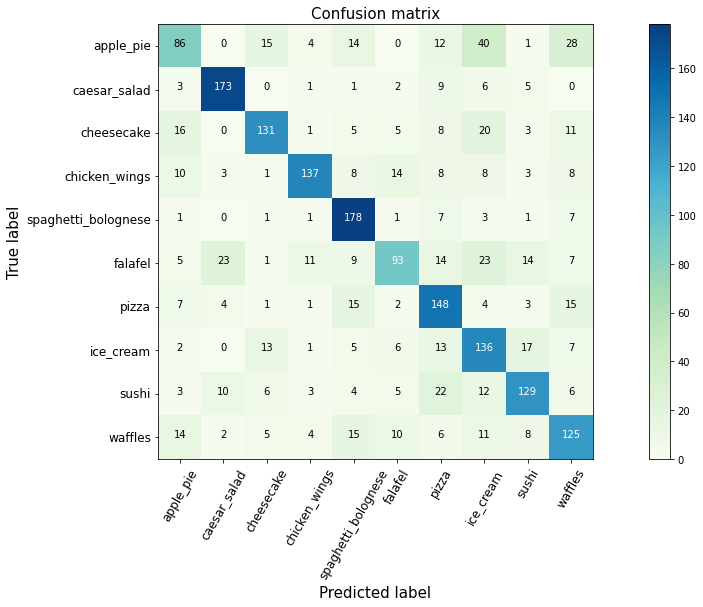

In [ ]:
model.load_weights('/content/drive/MyDrive/TrainedModels/AlexAug.hdf5')
eval_Model(model)

**By reducing the learning rate, the height of wave is decreased, so if we reduced learning rate more or incresed number of batch size, it will solve this problem. Also, the accuracy of the model after augmentation has increased from 58% to 66.8% which is quite good.**

### ResNet-50
**Here we import a pretained model that was trained on imageNet and we fine-tune it by customizing the output of the fuly connected layer to fir our dataset and requirements**

In [ ]:
# Loading Resnet with pretrained imagenet weights
# we remove the head block to define our block with 10 classes classification
# we changed input size from 224 to 227
ResModel = ResNet50(include_top=False,weights='imagenet',input_shape=(227, 227, 3))

94773248/94765736 [==============================] - 3s 0us/step


In [ ]:
#Golbal average pooling considers as a replacement of fullcy connected layer that flattening the dense layers and create one feature map
# Then adding 2 Fully connected layers
#Adding dropout to reduce overfitting, before the last fully connected layer
customHead = ResModel.output
customHead = GlobalAveragePooling2D()(customHead)
customHead = Dense(128, activation="relu")(customHead)
customHead = Dropout(0.5)(customHead)
customHead = Dense(10, activation="softmax")(customHead)

In [ ]:
ResModel=Model(inputs=ResModel.input, outputs=customHead)

In [ ]:
ResModel.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 227, 227, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 233, 233, 3)  0           input_3[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 114, 114, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 114, 114, 64) 256         conv1_conv[0][0]                 
______________________________________________________________________________________________

In [ ]:
ResModel.compile(optimizer = keras.optimizers.Adam() , loss = "categorical_crossentropy", metrics=["accuracy"])

**Here we add some callbacks to help in the overfitting problem like: early stopping, and reducing the learning rate; also, we create the TensorBoard Callback in order to view the model's information in TensorBoard**

In [ ]:
saveModel4 = tf.keras.callbacks.ModelCheckpoint(filepath='/content/drive/MyDrive/TrainedModels/ResNet50.h5', verbose=1, save_best_only=True, save_weights_only=True)
reduceLearningRate=tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.7, patience=5, verbose=1 ,mode='auto')
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir="/content/drive/MyDrive/logs")
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, verbose=True)

In [ ]:
history4=ResModel.fit_generator(
      train_Augmented,
      steps_per_epoch = train_Augmented.samples // 64,
      validation_data = val_generator, 
      validation_steps = val_generator.samples // 64,
      epochs = 50,verbose=1,callbacks=[saveModel4,reduceLearningRate,tensorboard_callback,early_stopping])

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1940: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '
/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


Epoch 1/50
125/125 [==============================] - 218s 2s/step - loss: 1.6098 - accuracy: 0.4930 - val_loss: 13.3313 - val_accuracy: 0.0998

Epoch 00001: val_loss improved from inf to 13.33135, saving model to /content/drive/MyDrive/TrainedModels/ResNet50.h5
Epoch 2/50
125/125 [==============================] - 208s 2s/step - loss: 1.1229 - accuracy: 0.6600 - val_loss: 2.4787 - val_accuracy: 0.1003

Epoch 00002: val_loss improved from 13.33135 to 2.47869, saving model to /content/drive/MyDrive/TrainedModels/ResNet50.h5
Epoch 3/50
125/125 [==============================] - 208s 2s/step - loss: 0.9744 - accuracy: 0.7017 - val_loss: 2.9561 - val_accuracy: 0.0993

Epoch 00003: val_loss did not improve from 2.47869
Epoch 4/50
125/125 [==============================] - 207s 2s/step - loss: 0.8654 - accuracy: 0.7369 - val_loss: 2.9009 - val_accuracy: 0.0998

Epoch 00004: val_loss did not improve from 2.47869
Epoch 5/50
125/125 [==============================] - 206s 2s/step - loss: 0.7844

In [ ]:
#Saving acc and loss logs
ResHist=pd.DataFrame(history4.history)
with open('/content/drive/MyDrive/ModelHistory/ResHist.csv', mode='w') as f:
    ResHist.to_csv(f) 

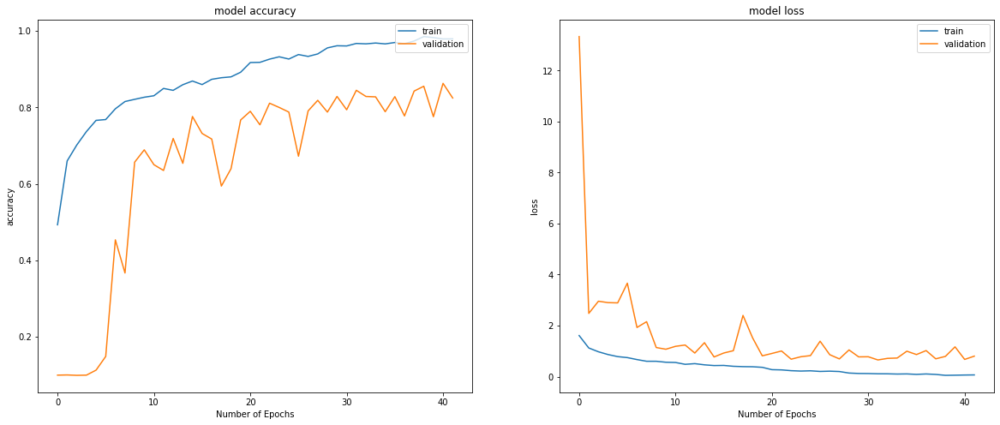

In [ ]:
#Loading acc and loss logs to plot Learning curve
hist4=pd.read_csv('/content/drive/MyDrive/ModelHistory/ResHist.csv')
evalFunction(hist4)

**The learning curve shows that the overfitting is reduced and the accuracy is much better than the AlexNet**

Found 2000 images belonging to 10 classes.


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:2001: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  warnings.warn('`Model.predict_generator` is deprecated and '



Accuracy score: 84.50

Classification Report: 
              precision    recall  f1-score   support

           0       0.74      0.78      0.76       192
           1       0.94      0.92      0.93       203
           2       0.86      0.70      0.77       245
           3       0.89      0.86      0.87       206
           4       0.90      0.98      0.93       183
           5       0.86      0.78      0.82       223
           6       0.87      0.94      0.90       186
           7       0.74      0.81      0.77       182
           8       0.81      0.87      0.84       186
           9       0.84      0.87      0.86       194

    accuracy                           0.84      2000
   macro avg       0.85      0.85      0.85      2000
weighted avg       0.85      0.84      0.84      2000



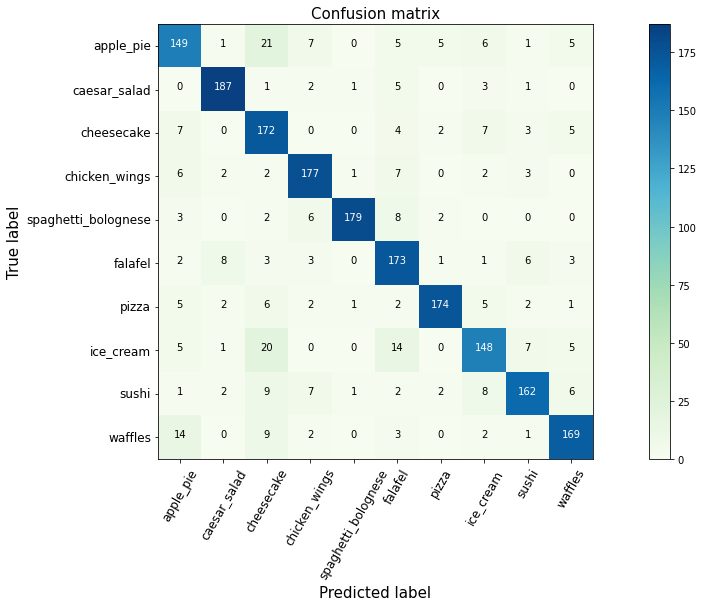

In [ ]:
#Loading best resnet model to evalute it
ResModel.load_weights('/content/drive/MyDrive/TrainedModels/ResNet50.h5')
eval_Model(ResModel)

**The accuracy score reported 84.5% whcih is much better than the AlexNet model <br> Below is the TensorBoard for the ResNet-50 Model for furthur evaluation information**

In [ ]:
# using tensorboard to show learning curves using the saved logs, while traning
%load_ext tensorboard

In [ ]:
%tensorboard --logdir '/content/drive/MyDrive/logs'

<IPython.core.display.Javascript object>

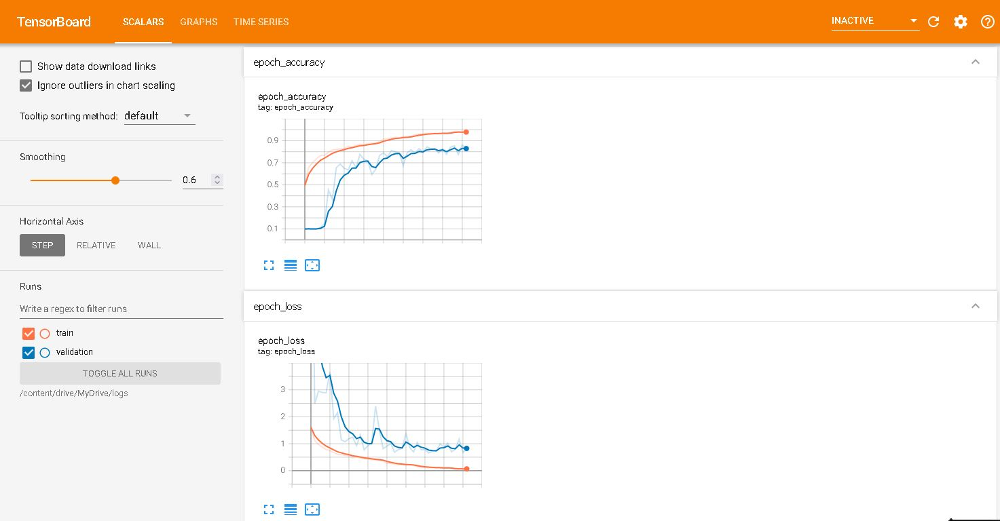

In [ ]:
img=cv2.imread('/content/drive/MyDrive/ResBoard.JPG')
cv2_imshow(img)

### Inception-V3
**As we did with the ResNet model, we imported a pretained model that was trained on imageNet and we fine-tune it by customizing the output of the fuly connected layer to fir our dataset and requirements**

In [ ]:
InceptionModel = InceptionV3(input_shape=(227, 227, 3),include_top=False,weights='imagenet')

In [ ]:
customHead = InceptionModel.output
customHead = GlobalAveragePooling2D()(customHead)
customHead = Dense(128, activation="relu")(customHead)
customHead = Dropout(0.5)(customHead)
customHead = Dense(10, activation="softmax")(customHead)

In [ ]:
InceptionModel=Model(inputs=InceptionModel.input, outputs=customHead)

In [ ]:
InceptionModel.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 227, 227, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 113, 113, 32) 864         input_4[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 113, 113, 32) 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, 113, 113, 32) 0           batch_normalization[0][0]        
____________________________________________________________________________________________

In [ ]:
InceptionModel.compile(optimizer = keras.optimizers.Adam() , loss = "categorical_crossentropy", metrics=["accuracy"])

In [ ]:
#Inception-specific Callbacks for tensorboard
saveModel5 = tf.keras.callbacks.ModelCheckpoint(filepath='/content/drive/MyDrive/TrainedModels/inceptionV3.h5', verbose=1, save_best_only=True, save_weights_only=True)
tensorboard_callback2 = tf.keras.callbacks.TensorBoard(log_dir="/content/drive/MyDrive/inceptionLogs")

In [ ]:
history5=InceptionModel.fit_generator(
      train_Augmented,
      steps_per_epoch = train_Augmented.samples // 64,
      validation_data = val_generator, 
      validation_steps = val_generator.samples // 64,
      epochs = 50,verbose=1,callbacks=[saveModel5,reduceLearningRate,tensorboard_callback2,early_stopping])

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1940: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/50
125/125 [==============================] - 199s 1s/step - loss: 1.3526 - accuracy: 0.5889 - val_loss: 71.7731 - val_accuracy: 0.1230

Epoch 00001: val_loss improved from inf to 71.77306, saving model to /content/drive/MyDrive/TrainedModels/inceptionV3.h5
Epoch 2/50
125/125 [==============================] - 191s 2s/step - loss: 0.9404 - accuracy: 0.7225 - val_loss: 1.5876 - val_accuracy: 0.4874

Epoch 00002: val_loss improved from 71.77306 to 1.58762, saving model to /content/drive/MyDrive/TrainedModels/inceptionV3.h5
Epoch 3/50
125/125 [==============================] - 193s 2s/step - loss: 0.8218 - accuracy: 0.7664 - val_loss: 2.2640 - val_accuracy: 0.5096

Epoch 00003: val_loss did not improve from 1.58762
Epoch 4/50
125/125 [==============================] - 192s 2s/step - loss: 0.6696 - accuracy: 0.8061 - val_loss: 2.4867 - val_accuracy: 0.3553

Epoch 00004: val_loss did not improve from 1.58762
Epoch 5/50
125/125 [==============================] - 192s 2s/step - loss: 

Found 2000 images belonging to 10 classes.


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:2001: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  warnings.warn('`Model.predict_generator` is deprecated and '



Accuracy score: 84.10

Classification Report: 
              precision    recall  f1-score   support

           0       0.73      0.71      0.72       206
           1       0.91      0.93      0.92       196
           2       0.85      0.78      0.81       219
           3       0.92      0.88      0.90       208
           4       0.92      0.98      0.95       186
           5       0.80      0.84      0.82       191
           6       0.74      0.97      0.84       153
           7       0.82      0.74      0.78       221
           8       0.84      0.84      0.84       200
           9       0.89      0.80      0.84       220

    accuracy                           0.84      2000
   macro avg       0.84      0.85      0.84      2000
weighted avg       0.84      0.84      0.84      2000



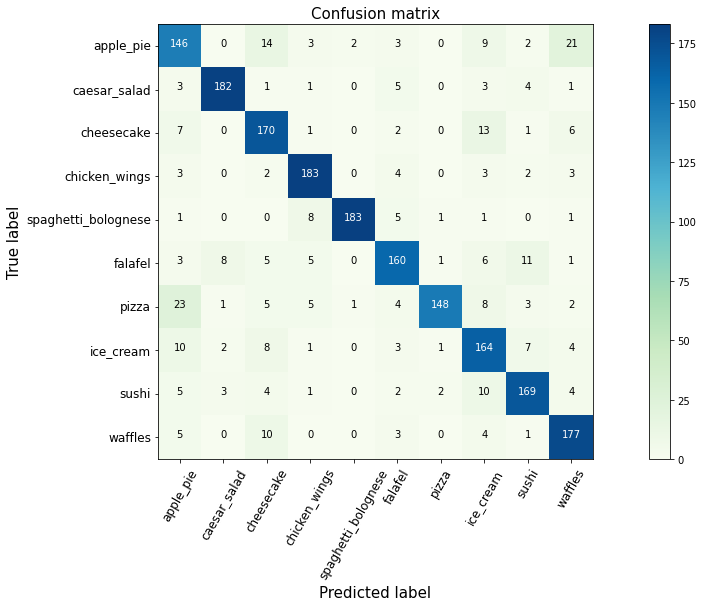

In [ ]:
InceptionModel.load_weights('/content/drive/MyDrive/TrainedModels/inceptionV3.h5')
eval_Model(InceptionModel)

**The accuracy score reported 84% whcih is much better than the AlexNet model as well and very close to the performance of the ResNet model<br> Below is the TensorBoard for the ResNet-50 Model for furthur evaluation information**

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir '/content/drive/MyDrive/inceptionLogs'

Reusing TensorBoard on port 6007 (pid 526), started 2:02:27 ago. (Use '!kill 526' to kill it.)

<IPython.core.display.Javascript object>

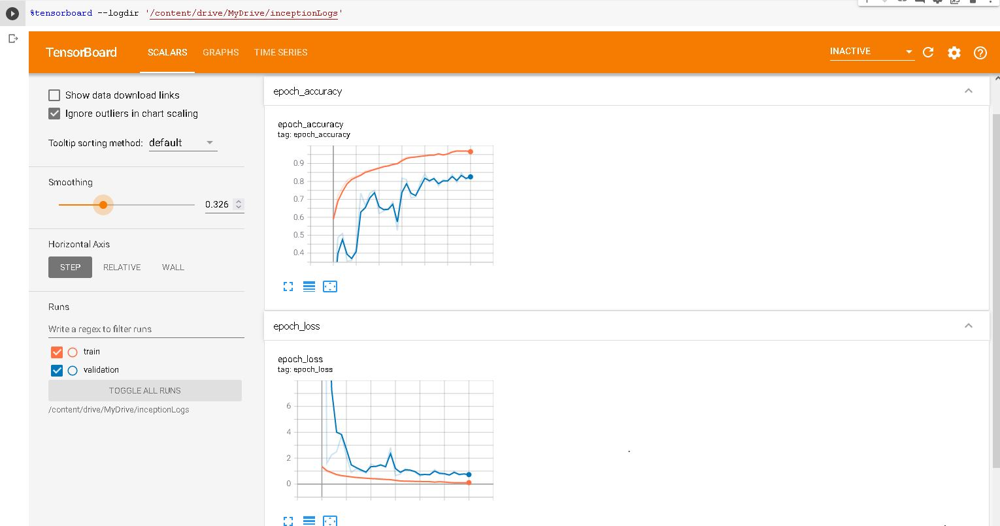

In [ ]:
img=cv2.imread('/content/drive/MyDrive/inceptionBoard.JPG')
cv2_imshow(img)

**Here we create a table that contains the best evalation information reported for each model built to compare between them and see which model is the best**

In [ ]:
import pandas as pd
#Load csv_With traning information
alexNoAug=pd.read_csv('/content/drive/MyDrive/ModelHistory/alexNoAugHist.csv')
alexAug=pd.read_csv('/content/drive/MyDrive/ModelHistory/alexAugHist2.csv')
resNetInfo=pd.read_csv('/content/drive/MyDrive/ModelHistory/ResHist.csv')

def get_less_Loss(model,name):
  model=model[model['val_loss'] == min(model['val_loss'])]
  model.rename(columns={"Unnamed: 0": "Model"},inplace=True)
  model['Model']=name
  return model

alexNoAug=get_less_Loss(alexNoAug,'AlexBeforeAugmentation')
alexAug=get_less_Loss(alexAug,'AlexAfterAugmentation')
resNet=get_less_Loss(resNetInfo,'ResNet50')

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4308: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.
/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4308: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-v

In [ ]:
train_Acc=pd.read_csv('/content/drive/MyDrive/run-train-tag-epoch_accuracy.csv')
train_loss=pd.read_csv('/content/drive/MyDrive/run-train-tag-epoch_loss.csv')
vaild_Acc=pd.read_csv('/content/drive/MyDrive/run-validation-tag-epoch_accuracy.csv')
vaild_loss=pd.read_csv('/content/drive/MyDrive/run-validation-tag-epoch_loss.csv')
index=vaild_loss[['Value']].idxmin()

In [ ]:
Inception=pd.DataFrame([['Inception',list(train_loss.loc[index,'Value'])[0],\
              list(train_Acc.loc[index,'Value'])[0],list(vaild_loss.loc[index,'Value'])[0],list(vaild_Acc.loc[index,'Value'])[0]]],\
              columns=['Model', 'loss', 'accuracy','val_loss','val_accuracy'])

In [ ]:
finalTable=pd.concat([alexNoAug, alexAug,resNet,Inception],ignore_index=True)
finalTable.drop('lr',axis=1,inplace=True)

In [ ]:
# All models are traing for 50 epochs, starting with LR 0.001
finalTable

,Model,loss,accuracy,val_loss,val_accuracy
0,AlexBeforeAugmentation,0.807406,0.743875,1.362099,0.589214
1,AlexAfterAugmentation,0.808131,0.744375,1.037957,0.668347
2,ResNet50,0.110963,0.967250,0.653874,0.844758
3,Inception,0.199724,0.943875,0.603288,0.841230


**After looking at the table above, we can see that the best reported validation accuracy is from the ResNet-50 model which is 84.5%.**

### Define prediction function

In [ ]:
from google.colab import files
#GetBestModel
ResModel.load_weights('/content/drive/MyDrive/TrainedModels/ResNet50.h5')
def prediction(model=ResModel):
  # Uploade image from computer
  uploaded = files.upload()
  #Get image name
  imgName=list(uploaded)[0]
  # read image, resize and resize it 
  img=cv2.imread('/content/'+imgName)
  img=cv2.resize(img,(227,227))
  norm=img/255.0
  norm=np.reshape(norm,(1, 227, 227, 3))
  #Feed it to the model
  pred=np.argmax(ResModel.predict(norm),axis=1)
  print('\n')
  cv2_imshow(img)
  print('\n')
  print('Predicted class is : '+str(classes_Names[pred[0]]))


Saving sushi.jpg to sushi (1).jpg




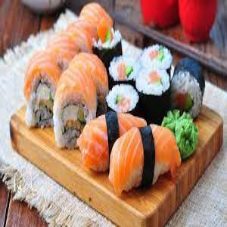



Predicted class is : sushi


In [ ]:
prediction()

Saving falfel.jpg to falfel.jpg




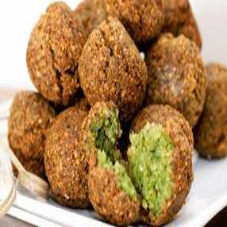



Predicted class is : falafel


In [ ]:
prediction()

Saving icecream.jpg to icecream.jpg




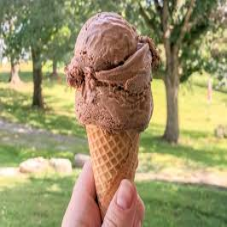



Predicted class is : ice_cream


In [ ]:
prediction()